## SVS Image Exploration and Preprocessing

Uses histology images stained with TP53 and images stained with H&E

In [1]:
import openslide
from openslide import open_slide
import os
from PIL import Image, ImageOps
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

In [2]:
#os.chdir('R:\A01_151219_svs')
os.chdir('/scratch/imb/Andrew/Slides')
os.getcwd()

'/scratch/imb/Andrew/Slides'

In [3]:
all_files = os.listdir(os.getcwd())

In [4]:
all_slides = [img for img in all_files if '.svs' in img]
all_slides

['1915_T_10464_3_HandE.svs',
 '1792_T_9500_2_TP53.svs',
 '2112_N_12341B_2_HandE.svs',
 '2075_T_9787_2_TP53.svs',
 '2011_T_9699_3_HandE.svs',
 '1820_T_105452F_2_HandE.svs',
 '1932_T_9876_2_TP53.svs',
 '2065_N_12752A_2_HandE.svs',
 '2019_T_9717_3_HandE.svs',
 '2090_T_10594_2_TP53.svs',
 '2011_T_9699_2_TP53.svs',
 '1910_T_9637_3_HandE.svs',
 '2148_N_11397A_2_HandE.svs',
 '2148_T_11393A_4_TP53.svs',
 '1928_T_9644_3_HandE.svs',
 '1794_T_9504_3_HandE.svs',
 '1957_T_9668_2_TP53.svs',
 '2023_T_9727_3_HandE.svs',
 '1794_T_9504_2_TP53.svs',
 '1939_T_9661_3_HandE.svs',
 '2171_T_11524A_2_HandE.svs',
 '1919_T_10779_3_HandE.svs',
 '2112_T_12335F_2_HandE.svs',
 '232_T_13230_3_HandE.svs',
 '1910_T_9637_2_TP53.svs',
 '1928_T_9644_2_TP53.svs',
 '2065_N_12752A_4_TP53.svs',
 '2112_T_12335F_4_TP53.svs',
 '526_T_15923_1_CDH1.svs',
 '1939_T_9661_2_TP53.svs',
 '526_T_15907_2_TP53.svs',
 '526_T_15907_1_CDH1.svs',
 '2148_N_11397A_4_TP53.svs',
 '1915_T_10464_2_TP53.svs',
 '2036_T_9729_3_HandE.svs',
 '2107_T_9806

In [5]:
TP53_all_imgs = [img for img in all_slides if 'TP53' in img]
TP53_all_imgs

['1792_T_9500_2_TP53.svs',
 '2075_T_9787_2_TP53.svs',
 '1932_T_9876_2_TP53.svs',
 '2090_T_10594_2_TP53.svs',
 '2011_T_9699_2_TP53.svs',
 '2148_T_11393A_4_TP53.svs',
 '1957_T_9668_2_TP53.svs',
 '1794_T_9504_2_TP53.svs',
 '1910_T_9637_2_TP53.svs',
 '1928_T_9644_2_TP53.svs',
 '2065_N_12752A_4_TP53.svs',
 '2112_T_12335F_4_TP53.svs',
 '1939_T_9661_2_TP53.svs',
 '526_T_15907_2_TP53.svs',
 '2148_N_11397A_4_TP53.svs',
 '1915_T_10464_2_TP53.svs',
 '2382_T_15360_2_TP53.svs',
 '2171_N_11521A_4_TP53.svs',
 '1798_T_9514_2_TP53.svs',
 '232_T_13230_2_TP53.svs',
 '2019_T_9717_2_TP53.svs',
 '526_T_15915_2_TP53.svs',
 '2112_N_12341B_4_TP53.svs',
 '1919_T_10779_2_TP53.svs',
 '2065_T_12756A_4_TP53.svs',
 '2023_T_9727_2_TP53.svs',
 '526_T_15923_2_TP53.svs',
 '1879_T_9580_2_TP53.svs',
 '1843_T_9561_2_TP53.svs',
 '2038_T_11986_2_TP53.svs',
 '2171_T_11524A_4_TP53.svs',
 '1820_N_10545A_4_TP53.svs',
 '2036_T_9729_2_TP53.svs',
 '2107_T_9806_2_TP53.svs',
 '1820_T_105452F_4_TP53.svs']

In [6]:
TP53_cancer_imgs = [img for img in all_slides if '.svs' in img and 'TP53' in img and '_T_' in img]

In [7]:
TP53_normal_imgs = [img for img in all_slides if '.svs' in img and 'TP53' in img and '_N_' in img]
TP53_normal_imgs

['2065_N_12752A_4_TP53.svs',
 '2148_N_11397A_4_TP53.svs',
 '2171_N_11521A_4_TP53.svs',
 '2112_N_12341B_4_TP53.svs',
 '1820_N_10545A_4_TP53.svs']

**View Images**

In [8]:
#wsi_path = 'C:/Users/Andrew/Pictures/IMB/'
wsi_path = '/scratch/imb/Andrew/Slides/'

wsi = open_slide(wsi_path + '2171_T_11524A_4_TP53.svs')
wsi_HE= open_slide(wsi_path + '2171_T_11524A_2_HandE.svs')
wsi_2 = open_slide(wsi_path + '2171_N_11521A_4_TP53.svs')
wsi_2_HE = open_slide(wsi_path + '2171_N_11521A_2_HandE.svs')

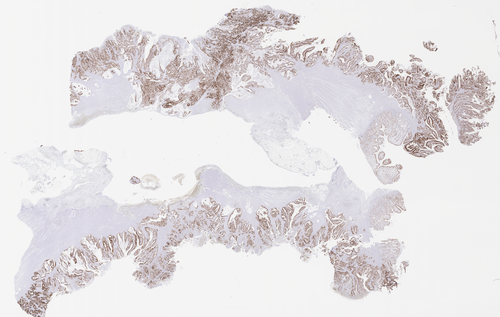

In [8]:
wsi.get_thumbnail((500,500))

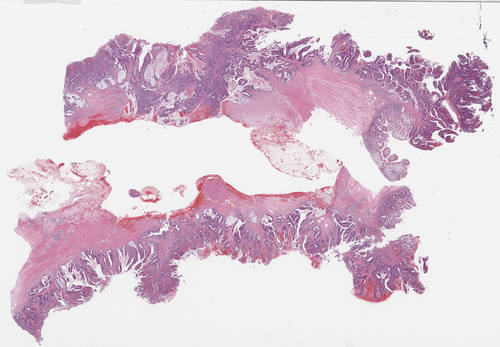

In [9]:
wsi_HE.get_thumbnail((500,500))

In [ ]:
wsi_2.get_thumbnail((500,500))

In [ ]:
wsi_2_HE.get_thumbnail((500,500))

In [ ]:
print(wsi.level_dimensions)
print(wsi_HE.level_dimensions)

In [281]:
wsi.properties['aperio.AppMag']

'20'

In [ ]:
wsi.associated_images

### Image Tiling

In [9]:
def wsi_tile_gen(wsi, level, tile_size, resize = None):
    """Generates tile from whole slide images
    """
    x_level, y_level = wsi.level_dimensions[level]
    x0, y0 = wsi.level_dimensions[0]
    x_scale, y_scale = x0/x_level, y0/y_level
    x_tiles = int(np.floor(x_level/tile_size))
    y_tiles = int(np.floor(y_level/tile_size))
    yield (x_tiles, y_tiles)
    tiles = []
    for y in range(y_tiles):
        for x in range(x_tiles):
            x_coord = round(x*x_scale*tile_size)
            y_coord = round(y*y_scale*tile_size)
            tile = wsi.read_region((x_coord, y_coord), level, (tile_size, tile_size))
            if resize == 13:
                yield tile.resize((13,13), resample = Image.BICUBIC)
            elif resize == 299:
                yield tile.resize((299,299), resample = Image.BICUBIC)
            else:
                yield tile 
    
def plot_tiles(tile_gen, tile_size):
    w, h = tile_size
    x_tiles, y_tiles = next(tile_gen)
    tiled = Image.new('RGB', (w*x_tiles, h*y_tiles))
    for y in range(y_tiles):
        for x in range(x_tiles):
            tile_border = ImageOps.expand(next(tile_gen), 2)
            tiled.paste(tile_border, (x*w, y*h))
    return tiled

def plot_mask(tile_gen, tile_size, background_mask, fill = 'red'):
    w, h = tile_size
    x_tiles, y_tiles = next(tile_gen)
    tiled = Image.new('RGB', (w*x_tiles, h*y_tiles))
    i = 0
    for y in range(y_tiles):
        for x in range(x_tiles):
            if background_mask.ravel()[i] == 0:
                colour = fill
            else:
                colour = 'grey'
            tile_border = add_border(next(tile_gen), round(w*0.03), fill = colour)
            tiled.paste(tile_border, (x*w, y*h))
            i += 1
    return tiled

def add_border(img, width, fill):
    w, h = img.size
    img = img.crop((width, width, w-width, h-width))
    img_bordered = ImageOps.expand(img, width, fill = fill)
    return img_bordered
    
def tile_mask(tile_gen, eval_func):
    mask = []
    shape = next(tile_gen)
    for tile in tile_gen:
        r,g,b,a = tile.resize((1,1)).getpixel((0,0))
        if eval_func(r,g,b,a) == True:
            mask.append(1)
        else: mask.append(0)
    return np.reshape(mask, shape)

def threshold_mask(tile_gen, threshold):
    threshold_func = lambda r,g,b,a: True if r>threshold and g>threshold and b>threshold else False
    return tile_mask(tile_gen, threshold_func)

def tissue(tile_gen, background_mask):
    tissue = []
    shape = next(tile_gen)
    i = 0
    for img in tile_gen:
        if background_mask.ravel()[i] == 0:
            tissue.append(img)
        i += 1
    return tissue         

In [ ]:
plot_tiles(tgen, (100,100))

In [ ]:
tgen = wsi_tile_gen(wsi, 3, 50)
background_mask = threshold_mask(tgen, 240.5)
tgen = wsi_tile_gen(wsi, 3, 50)
mask = threshold_mask(tgen, 205)
tgen = wsi_tile_gen(wsi, 3, 50)
plot_mask(tgen, (50,50), background_mask)

In [ ]:
tgen = wsi_tile_gen(wsi, 3, 50)
tissue_tiles = tissue(tgen, mask)

In [ ]:
hist = tissue_tiles[21].histogram()

### Image Thresholding

In [10]:
from skimage.filters import threshold_minimum
from skimage.filters import threshold_otsu, threshold_local

In [11]:
def compare_threshold(original_img, thresholded_img, threshold):
    fig, ax = plt.subplots(2, 2, figsize=(10, 10))

    ax[0, 0].imshow(original_img, cmap=plt.cm.gray)
    ax[0, 0].set_title('Original')

    ax[0, 1].hist(np.array(original_img).ravel(), bins=256)
    ax[0, 1].set_title('Histogram')

    ax[1, 0].imshow(thresholded_img*255, cmap=plt.cm.gray)
    ax[1, 0].set_title('Thresholded (min)')

    ax[1, 1].hist(np.array(original_img).ravel(), bins=256)
    ax[1, 1].axvline(threshold, color='r')

    for a in ax[:, 0]:
        a.axis('off')
        
    fig.tight_layout()
    return plt

def local_otsu(img, block_size):
    img_bw = img.convert('L')
    local_thresh = threshold_local(np.array(img_bw), block_size, offset = 0)
    binary_local = img_bw > local_thresh
    return binary_local

In [ ]:
wsi_small = wsi.get_thumbnail((1000,1000))
wsi_small_bw = wsi_small.convert('L')

In [ ]:
thresh_min = 235
binary_min = np.array(wsi_small_bw) > thresh_min

compare_threshold(wsi_small_bw, binary_min, thresh_min)

In [ ]:
thresh_otsu = threshold_otsu(np.array(wsi_small_bw))
binary_otsu = np.array(wsi_small_bw) > thresh_otsu
compare_threshold(wsi_small_bw, binary_otsu, thresh_otsu)

**Local Otsu Thresholding**
</p> This seems good to segmenting the tissue from the background. 
It seems robust enough to not get tricked by slight changes in lighting across the slide </p>

In [ ]:
#Larger block sizes seems to work better but also takes longer to compute
block_size = 10001
plt.imshow(local_otsu(wsi_small, block_size), plt.cm.gray)

In [ ]:
#Plot of local thresholds
plt.imshow(local_thresh, cmap = plt.cm.gray)

In [ ]:
fig, ax = plt.subplots(2, 1, figsize=(20, 20))
ax[0].imshow(wsi_small_bw, cmap=plt.cm.gray)
#ax[0].imshow(ihc_d_rescale, cmap=plt.cm.gray)
ax[1].imshow(binary_local, cmap=plt.cm.gray)
ax[0].axis('off')
ax[1].axis('off')
fig.tight_layout()

### Image Stain Segmentation

In [90]:
from skimage.color import rgb2hed
from matplotlib.colors import LinearSegmentedColormap

In [ ]:
cmap_hema = LinearSegmentedColormap.from_list('mycmap', ['white', 'navy'])
cmap_dab = LinearSegmentedColormap.from_list('mycmap', ['white','saddlebrown'])
cmap_eosin = LinearSegmentedColormap.from_list('mycmap', ['darkviolet','white'])

In [ ]:
ihc_hed = rgb2hed(wsi_small)

In [ ]:
fig, axes = plt.subplots(2, 2, figsize=(7, 6), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(wsi_small)
ax[0].set_title("Original image")

ax[1].imshow(ihc_hed[:, :, 0], cmap=cmap_hema)
ax[1].set_title("Hematoxylin")

ax[2].imshow(ihc_hed[:, :, 1], cmap=cmap_eosin)
ax[2].set_title("Eosin")

ax[3].imshow(ihc_hed[:, :, 2], cmap=cmap_dab)
ax[3].set_title("DAB")

for a in ax.ravel():
    a.axis('off')

fig.tight_layout()

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(20, 20), sharex=True, sharey=True)
ax = axes.ravel()
#ax[0].imshow(ihc_hed[:, :, 0], cmap=cmap_hema)
ax[0].imshow(-ihc_hed[:, :, 0], cmap=plt.cm.gray)
ax[0].set_title("Hematoxylin")
#ax[1].imshow(ihc_hed[:, :, 2], cmap=cmap_dab)
ax[1].imshow(-ihc_hed[:, :, 2], cmap=plt.cm.gray)
ax[1].set_title("DAB")
ax[2].imshow(wsi_small)
ax[2].set_title("Original image")

In [ ]:
#Separte out the stains and invert the images
ihc_h = -ihc_hed[:, :, 0]
ihc_d = -ihc_hed[:, :, 2]

Stretch the constrast of the images so the staining is more visible

In [362]:
from skimage import exposure
def stretch_contrast(img, p_low = 2, p_high = 98):
    p2, p98 = np.percentile(img, (p_low, p_high))
    return exposure.rescale_intensity(img, in_range=(p2, p98))

In [ ]:
ihc_h_rescale = stretch_contrast(ihc_h)
ihc_d_rescale = stretch_contrast(ihc_d)

In [ ]:
plt.imshow(ihc_h_rescale)

In [29]:
#IMG = ihc_d_rescale
IMG = dab

Otsu thresholding on hematoxylin images - could be promising for segmentation of tissue from background

0.5540017154291678


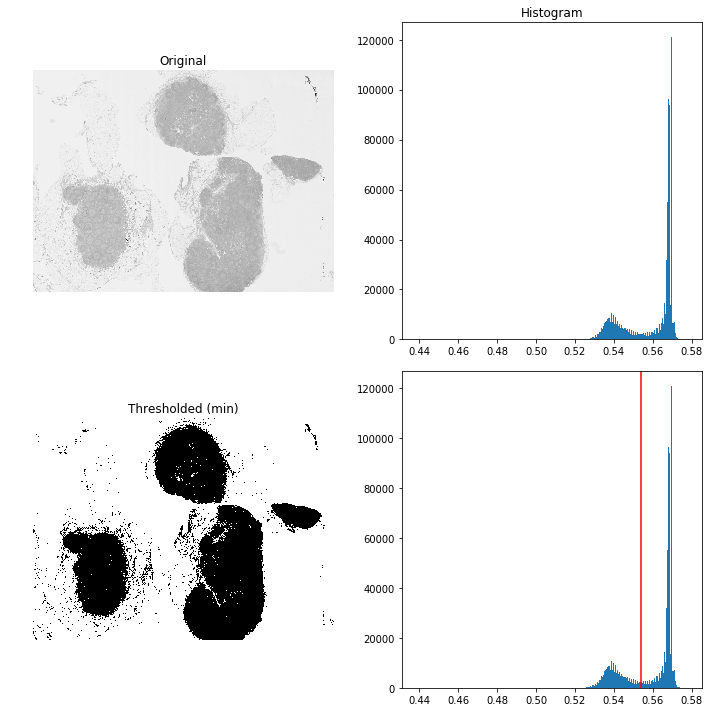

In [273]:
thresh_otsu = threshold_otsu(hem)
hem_binary_otsu = hem > thresh_otsu
compare_threshold(hem, hem_binary_otsu, thresh_otsu)
print(thresh_otsu)

Otsu thresholding on DAB images - useful for segment TP53 positve areas from rest of slide

0.4091348683273929


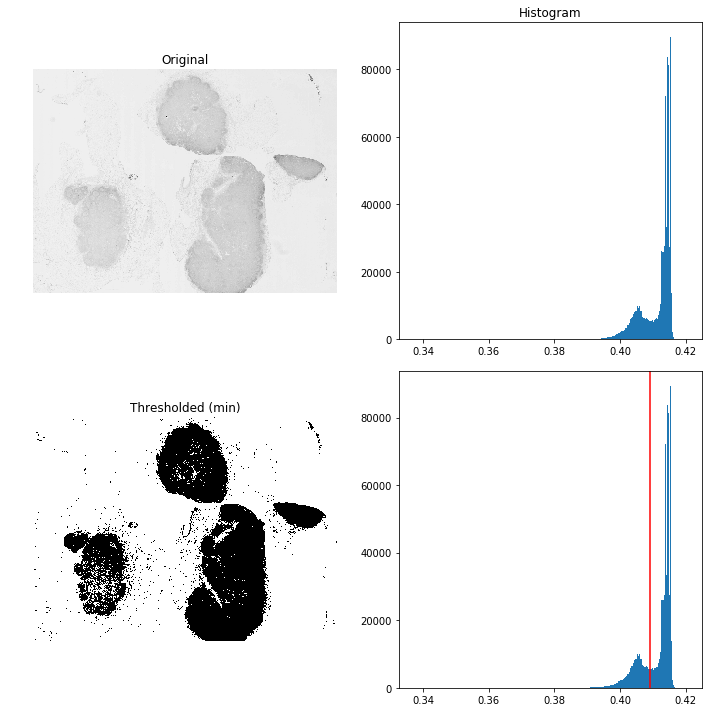

In [275]:
thresh_otsu = threshold_otsu(IMG)
dab_binary_otsu = IMG > thresh_otsu
compare_threshold(IMG, dab_binary_otsu, thresh_otsu)
print(thresh_otsu)

Manual thresholding of DAB images - may give better results but more tedious than otsu

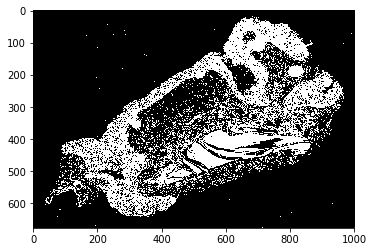

In [170]:
plt.imshow(~hem_binary_otsu, cmap = plt.cm.gray)

In [174]:
dab_binary_otsu[hem_binary_otsu] = 0

In [216]:
dab_masked = dab.copy()

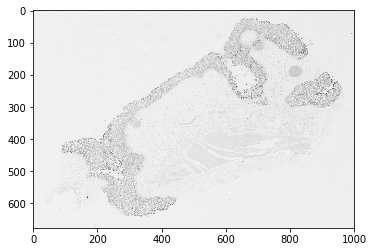

In [260]:
plt.imshow(dab, cmap = plt.cm.gray)

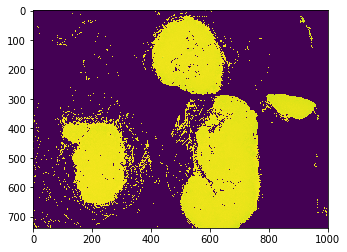

In [276]:
dab_masked = np.where(hem_binary_otsu == False, dab, 0)
plt.imshow(dab_masked)

(array([1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00,
        0.00000e+00, 1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 1.00000e+00, 0.00000e+00, 1.00000e+00, 0.00000e+00,
        1.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00,
        1.00000e+00, 2.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00,
        1.00000e+00, 0.00000e+00, 0.00000e+00, 1.00

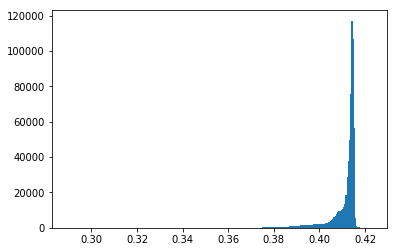

In [251]:
plt.hist(np.array(dab).ravel(), bins=256)

(array([5.19148e+05, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00

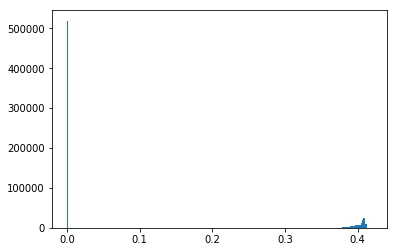

In [252]:
plt.hist(np.array(dab_masked).ravel(), bins=256)

In [244]:
dab_masked

array([[0.41415421, 0.41423243, 0.41415421, ..., 0.41186695, 0.41218961,
        0.41218961],
       [0.41466332, 0.41466332, 0.41474143, ..., 0.41186695, 0.41218961,
        0.41186695],
       [0.41474143, 0.41466332, 0.41474143, ..., 0.41218961, 0.41218961,
        0.41218961],
       ...,
       [0.41524976, 0.41524976, 0.41524976, ..., 0.        , 0.        ,
        0.        ],
       [0.41524976, 0.41524976, 0.41524976, ..., 0.        , 0.        ,
        0.40506582],
       [0.41524976, 0.41524976, 0.41524976, ..., 0.41097473, 0.40870028,
        0.41197876]])

In [230]:
hem_binary_otsu

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ..., False, False, False],
       [ True,  True,  True, ..., False, False,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

<module 'matplotlib.pyplot' from '/usr/local/lib/python3.5/dist-packages/matplotlib/pyplot.py'>

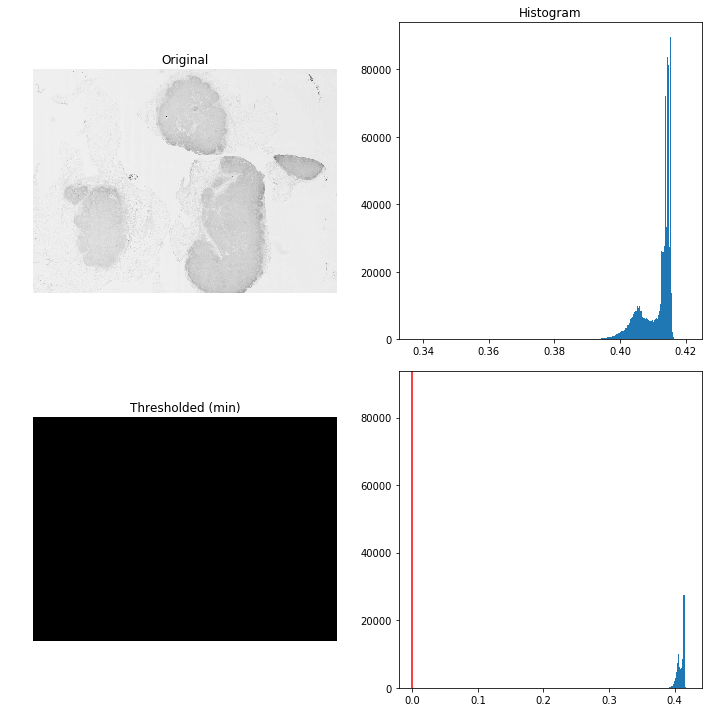

In [38]:
thresh_min = 0
binary_min = IMG > thresh_min
compare_threshold(IMG, binary_min, thresh_min)

In [39]:
binary_min[1]

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

Pixels             :2245709165
Max readable pixels:536870912


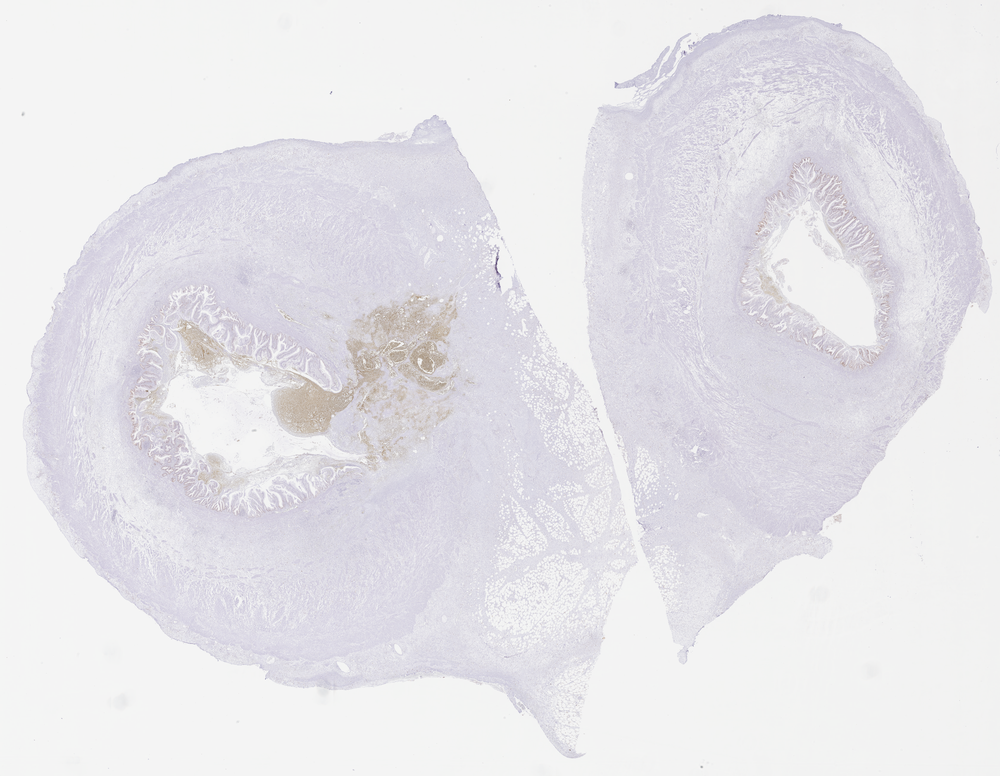

In [264]:
img = open_slide(wsi_path + TP53_normal_imgs[4])
print('Pixels             :' + str(img.level_dimensions[LEVEL][0]*img.level_dimensions[LEVEL][1]))
print('Max readable pixels:' + str(2**29))
img_small = img.get_thumbnail((1000,1000))
img_small

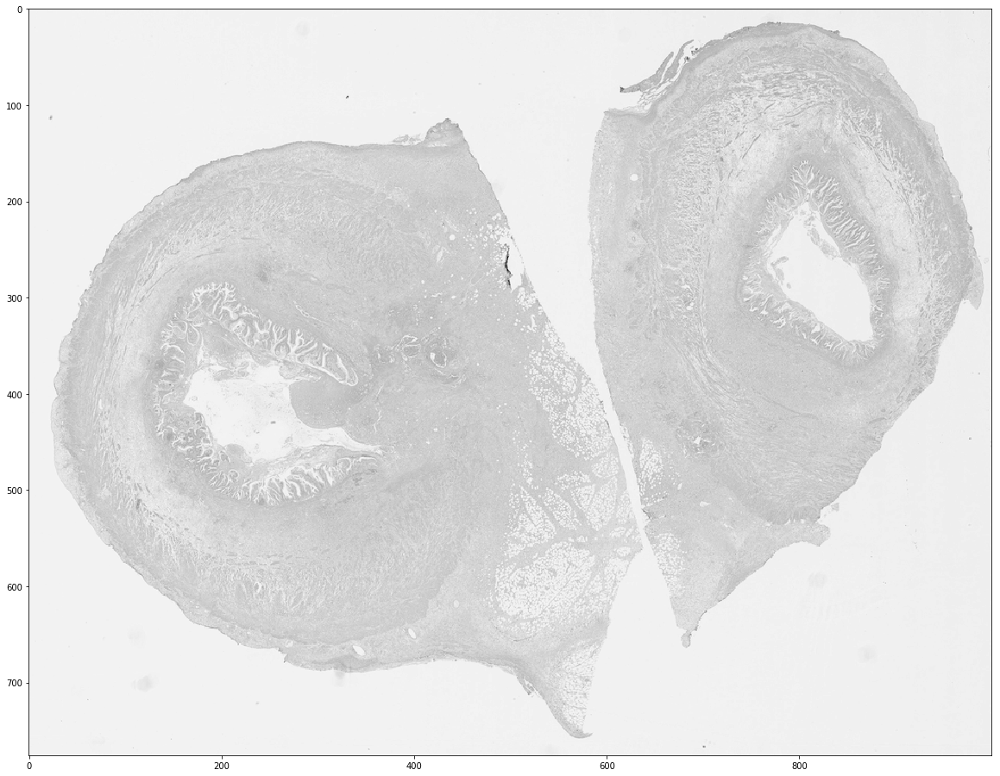

In [265]:
hed = rgb2hed(img_small)
dab = -hed[:, :, 2]
hem = -hed[:,:, 0]
fig, ax = plt.subplots(figsize = (20,20))
ax.imshow(hem, cmap = plt.cm.gray)

**Histogram of masked Dab image**

Get binary mask of tissue

In [150]:
from skimage.exposure import histogram

0.5582783957419297


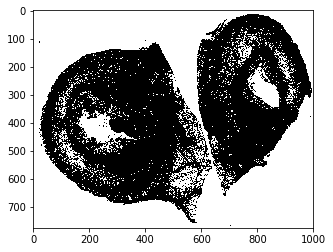

In [266]:
thresh_otsu = threshold_otsu(hem)
hem_binary_otsu = hem > thresh_otsu
plt.imshow(hem_binary_otsu, cmap = plt.cm.gray)
print(thresh_otsu)

Use binary mask to mask out background of dab image

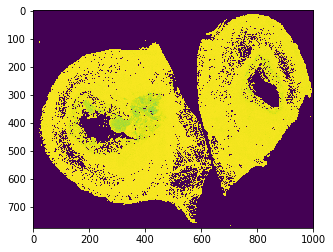

In [267]:
dab_masked = np.where(hem_binary_otsu == False, dab, 0)
plt.imshow(dab_masked)

Otsu thresholding on unmasked (non zero) areas of image

In [268]:
dab_values = np.array([i for i in dab_masked.ravel() if i != 0])

In [269]:
hist, bin_centers = histogram(dab_values, 256, source_range='image')
hist = hist.astype(float)

# class probabilities for all possible thresholds
weight1 = np.cumsum(hist)
weight2 = np.cumsum(hist[::-1])[::-1]
# class means for all possible thresholds
mean1 = np.cumsum(hist * bin_centers) / weight1
mean2 = (np.cumsum((hist * bin_centers)[::-1]) / weight2[::-1])[::-1]

# Clip ends to align class 1 and class 2 variables:
# The last value of `weight1`/`mean1` should pair with zero values in
# `weight2`/`mean2`, which do not exist.
variance12 = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2

idx = np.argmax(variance12)
threshold = bin_centers[:-1][idx]
print(threshold)

otsu_thresh = threshold_otsu(dab)
print(otsu_thresh)

0.3932127391415152
0.3965357969074804


In [270]:
variance12[idx]

5158175.964975023

367890

In [357]:
mean1[idx]

0.3888098972281996

In [358]:
mean2[idx]

0.40658766521555634

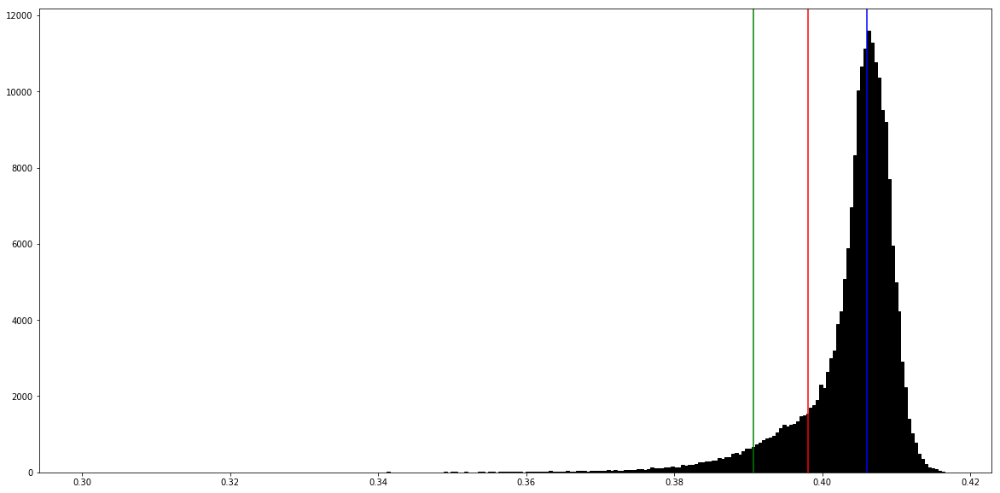

In [172]:
fig, ax = plt.subplots(figsize = (20,10))
_, __ , ___= ax.hist(dab_masked.ravel(), bins = 256, range = (0.3,0.417), fc='k', ec='k')
plt.axvline(threshold, color='r')
plt.axvline(mean1[idx], color='g')
plt.axvline(mean2[idx], color = 'b')

<module 'matplotlib.pyplot' from '/usr/local/lib/python3.5/dist-packages/matplotlib/pyplot.py'>

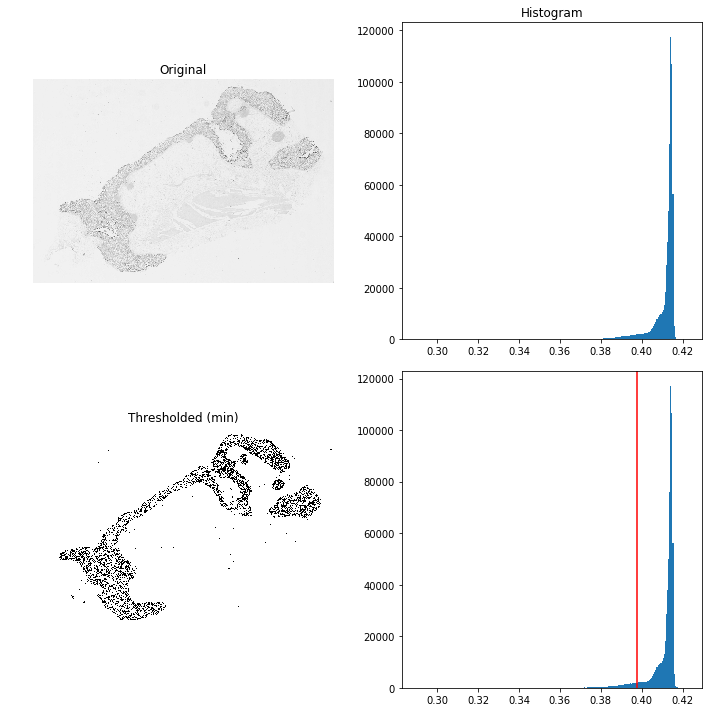

In [360]:
binary_min = dab > threshold
compare_threshold(dab, binary_min, threshold)

In [13]:
def threshold_otsu_masked(hed_img):
    dab = -hed_img[:, :, 2]
    hem = -hed_img[:,:, 0]
    hem_thresh = threshold_otsu(hem)
    hem_binary_otsu = hem > hem_thresh
    #Use binary mask to mask out background of DAB images
    dab_masked = np.where(hem_binary_otsu == False, dab, 0)
    dab_values = np.array([i for i in dab_masked.ravel() if i != 0])
    #Otsu Thresholding
    hist, bin_centers = histogram(dab_values, 256, source_range='image')
    hist = hist.astype(float)
    # class probabilities for all possible thresholds
    weight1 = np.cumsum(hist)
    weight2 = np.cumsum(hist[::-1])[::-1]
    # class means for all possible thresholds
    mean1 = np.cumsum(hist * bin_centers) / weight1
    mean2 = (np.cumsum((hist * bin_centers)[::-1]) / weight2[::-1])[::-1]
    # Clip ends to align class 1 and class 2 variables:
    # The last value of `weight1`/`mean1` should pair with zero values in
    # `weight2`/`mean2`, which do not exist.
    variance12 = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2
    idx = np.argmax(variance12)
    #Consider all cells are normal if variance is too small
    if variance12[idx] < 500000:
        threshold = 0
    else:
        threshold = bin_centers[:-1][idx]
    return threshold



#### Tile labelling for TP53

In [14]:

def tile_gen(img, tile_size):
    '''Input is Pillow Image
    '''
    width, height = img.size
    x_tiles = int(np.floor(width/tile_size))
    y_tiles = int(np.floor(height/tile_size))
    yield (x_tiles, y_tiles)
    for y in range(y_tiles):
        for x in range(x_tiles):
            x_coord = x*tile_size
            y_coord = y*tile_size
            yield img.crop((x_coord, y_coord, x_coord+tile_size, y_coord+tile_size))
            
def ihc2gray(img):
    img_rescaled = (img*255).astype('uint8')
    return Image.fromarray(img_rescaled).convert('L')
    
def cancer_mask(tile_gen, threshold):
    mask = []
    shape = next(tile_gen)
    for tile in tile_gen:
        if np.array(tile).mean() < threshold:
            mask.append(0)
        else:
            mask.append(1)
    return np.reshape(mask, shape)

def tissue_mask(tile_gen, threshold):
    mask = []
    shape = next(tile_gen)
    for tile in tile_gen:
        if np.array(tile).mean() < threshold:
            mask.append(0)
        else:
            mask.append(1)
    return np.reshape(mask, shape)

def tissue_mask_local(wsi, level):
    Image.MAX_IMAGE_PIXELS = 10000000000 
    tile_size = 299
    multiplier = 13
    x_wsi, y_wsi = wsi.level_dimensions[level]
    img = wsi.read_region((0,0), level, (x_wsi, y_wsi)).convert('RGB')
    img_cropped = img.crop((0,0, x_wsi - x_wsi%tile_size, y_wsi - y_wsi%tile_size))
    x_tiles, y_tiles = np.floor_divide(x_wsi, tile_size), np.floor_divide(y_wsi, tile_size)
    img_small = img_cropped.resize((x_tiles*multiplier, y_tiles*multiplier), resample = Image.BICUBIC)
    binary_img_small = local_otsu(img_small, get_block_size(x_tiles*multiplier, y_tiles*multiplier))
    t_mask_tgen = tile_gen(ihc2gray(binary_img_small), multiplier)
    t_mask = tissue_mask(t_mask_tgen, 240)
    return t_mask

def wsi_tissue_mask(wsi, level, half_res = False):
    #Use for 299x299 tiles
    if half_res == True:
        down_factor = 46
    else:
        down_factor = 23
    x_wsi, y_wsi = wsi.level_dimensions[level]
    x_small, y_small = np.floor_divide(x_wsi, down_factor), np.floor_divide(y_wsi, down_factor)
    level_best = wsi.get_best_level_for_downsample(down_factor)
    size_best = wsi.level_dimensions[level_best]
    img = wsi.read_region((0,0), level_best, size_best).convert('RGB')
    img_small = img.resize((x_small, y_small), resample = Image.BICUBIC)
    binary_img_small = local_otsu(img_small, get_block_size(x_small, y_small))
    t_mask_gen = tile_gen(ihc2gray(binary_img_small), 13)
    t_mask = tissue_mask(t_mask_gen, 240)
    return t_mask
    

def get_block_size(x, y):
    max_dim = max(x,y)
    if max_dim%2 == 0:
        return max_dim + 1
    else: 
        return max_dim 

def dab_mask_gen(wsi, tile_size, level = None):
    """Dab mask generator for Pillow img and WSI
    """
    if type(wsi) == openslide.OpenSlide:
        wsi_size = wsi.level_dimensions[level]
        img = wsi.read_region((0,0), level, wsi_size)
    else:
        img = wsi
    hed = rgb2hed((img).convert('RGB'))
    dab = -hed[:, :, 2]
    threshold = threshold_otsu(dab)
    binary_dab = dab > threshold
    return tile_gen(ihc2gray(binary_dab), tile_size)

def wsi_cancer_mask(wsi, level, cancer_thresh, force_thresh = None, half_res = False):
    """Creates cancer mask for whole slide images
       where cancer cells are stained with DAB
       Each array value corresponds to a 299x299 tile 
       Uses Otsu thresholding with background masking
    """
    #Determine Dab Threshold using a small (up to 1000x1000) image
    if not force_thresh:
        img_small = wsi.get_thumbnail((1000,1000))
        hed_small = rgb2hed(img_small)
        dab_thresh = threshold_otsu_masked(hed_small)
    else:
        dab_thresh = force_thresh
    print('Threshold: ' + str(dab_thresh))
    #Create Mask using full resolution wsi
    if half_res == False:
        tile_gen = wsi_tile_gen(wsi, level, 299)
    if half_res == True:
        tile_gen = wsi_tile_gen(wsi, level, 598, 299)
    mask = []
    shape = next(tile_gen)
    for tile in tile_gen:
        #Resize image to increase speed
        tile = tile.convert('RGB')
        tile_small = tile.resize((13,13), resample = Image.LINEAR)
        tile_hed = rgb2hed(tile_small)
        tile_dab = -tile_hed[:, :, 2]
        binary_dab = tile_dab > dab_thresh
        if np.array(ihc2gray(binary_dab)).mean() < cancer_thresh:
            mask.append(0)
        else:
            mask.append(1)
    return np.reshape(mask, shape)  

def wsi_cancer_masks(wsi, level, cancer_thresh, non_cancer_thresh, force_thresh = None, half_res = False):
    """Creates cancer mask for whole slide images
       where cancer cells are stained with DAB
       Each array value corresponds to a 299x299 tile 
       Uses Otsu thresholding with background masking
    """
    #Determine Dab Threshold using a small (up to 1000x1000) image
    if not force_thresh:
        img_small = wsi.get_thumbnail((1000,1000))
        hed_small = rgb2hed(img_small)
        dab_thresh = threshold_otsu_masked(hed_small)
    else:
        dab_thresh = force_thresh
    print('Threshold: ' + str(dab_thresh))
    #Create Mask using full resolution wsi
    if half_res == False:
        tile_gen = wsi_tile_gen(wsi, level, 299)
    if half_res == True:
        tile_gen = wsi_tile_gen(wsi, level, 598, 299)
    c_mask = []
    u_mask = []
    shape = next(tile_gen)
    for tile in tile_gen:
        #Resize image to increase speed
        tile = tile.convert('RGB')
        tile_small = tile.resize((13,13), resample = Image.LINEAR)
        tile_hed = rgb2hed(tile_small)
        tile_dab = -tile_hed[:, :, 2]
        binary_c_dab = tile_dab > dab_thresh
        binary_non_c_dab = tile_dab > non_cancer_thresh
        if np.array(ihc2gray(binary_c_dab)).mean() < cancer_thresh:
            c_mask.append(0)    #Is Cancer
            u_mask.append(1)
        else:
            c_mask.append(1)
            if np.array(ihc2gray(binary_non_c_dab)).mean() < cancer_thresh:
                u_mask.append(0)
            else:
                u_mask.append(1)
    return np.reshape(c_mask, shape), np.reshape(u_mask, shape)

def wsi_cancer_mask_2(wsi, level, cancer_thresh, tile_size):
    Image.MAX_IMAGE_PIXELS = 10000000000 
    multiplier = 1
    x_wsi, y_wsi = wsi.level_dimensions[level]
    img = wsi.read_region((0,0), level, wsi_size).convert('RGB')
    img_cropped = img.crop((0,0, x_wsi - x_wsi%tile_size, y_wsi - y_wsi%tile_size))
    x_tiles, y_tiles = np.floor_divide(x_wsi, tile_size), np.floor_divide(y_wsi, tile_size)
    img_small = img_cropped.resize((x_tiles*multiplier, y_tiles*multiplier), resample = Image.BICUBIC)
    hed = rgb2hed(img_small)
    dab = -hed[:, :, 2]
    dab_thresh = threshold_otsu(dab)
    binary_dab = dab > dab_thresh
    return img_small

def wsi_cancer_mask_fast(wsi, level, cancer_thresh, tile_size):
    x_wsi, y_wsi = wsi.level_dimensions[level]
    x_tiles, y_tiles = np.floor_divide(x_wsi, tile_size), np.floor_divide(y_wsi, tile_size)
    level_best = wsi.get_best_level_for_downsample(tile_size)
    size_best = wsi.level_dimensions[level_best]
    img = wsi.read_region((0,0), level_best, size_best).convert('RGB')
    img_small = img.resize((x_tiles, y_tiles), resample = Image.BICUBIC)
    hed = rgb2hed(img_small)
    dab = -hed[:, :, 2]
    dab_thresh = threshold_otsu(dab)
    binary_dab = dab > dab_thresh
    return binary_dab
    
    
def save_tiles(path, tile_gen, cancer_mask, tissue_mask, prefix = ''):
    #os.makedirs('cancer')
    #os.makedirs('normal')
    x_tiles, y_tiles = next(tile_gen)
    print('Whole Image Size is {0} x {1}'.format(x_tiles, y_tiles))
    i = 0 
    for tile in tile_gen:
        img = tile.convert('RGB')
        #Name tile as horizontal position _ vertical position starting at (0,0)
        tile_name = prefix + str(np.floor_divide(i,x_tiles)) + '_' +  str(i%x_tiles) 
        if cancer_mask.ravel()[i] == 0:
            img.save(path + 'cancer/' + tile_name + '.jpeg', 'JPEG')
        elif tissue_mask.ravel()[i] == 0:
            img.save(path + 'normal/' + tile_name + '.jpeg', 'JPEG')
        i += 1
    print('Done')
    
def save_gold_tiles(tile_gen, cancer_mask, tissue_mask, uncertain_mask, prefix = ''):
    x_tiles, y_tiles = next(tile_gen)
    print('Whole Image Size is {0} x {1}'.format(x_tiles, y_tiles))
    i = 0 
    path = '../gold_standards/10x/'
    for tile in tile_gen:
        img = tile.convert('RGB')
        #Name tile as horizontal position _ vertical position starting at (0,0)
        tile_name = prefix + '_' + str(np.floor_divide(i,x_tiles)) + '_' +  str(i%x_tiles) 
        if cancer_mask.ravel()[i] == 0:
            img.save(path + 'cancer/' + tile_name + '.jpeg', 'JPEG')
        elif tissue_mask.ravel()[i] == 0 and uncertain_mask.ravel()[i] == 1:
            img.save(path + 'normal/' + tile_name + '.jpeg', 'JPEG')
        i += 1
    print('Done')

In [195]:
def plot_masks(tile_gen, tile_size, tissue_mask, cancer_mask, fill = 'red', uncertain_mask = None):
    w, h = tile_size
    x_tiles, y_tiles = next(tile_gen)
    tiled = Image.new('RGB', (w*x_tiles, h*y_tiles))
    i = 0
    for y in range(y_tiles):
        for x in range(x_tiles):
            if cancer_mask.ravel()[i] == 0:
                colour = fill
            elif uncertain_mask is not None and uncertain_mask.ravel()[i] == 0:
                colour = 'orange'
            elif tissue_mask.ravel()[i] == 0:
                colour = 'lime'
            else: 
                colour = 'silver'
            tile_border = add_border(next(tile_gen), int(np.ceil(w*0.03)), fill = colour)
            tiled.paste(tile_border, (x*w, y*h))
            i += 1
    return tiled

In [ ]:
tgen = wsi_tile_gen(wsi, 2, 299)

In [ ]:
size = 20
dab_mask_tgen = dab_mask_gen(wsi, size, 3)
c_mask = cancer_mask(dab_mask_tgen, 250)
tgen = wsi_tile_gen(wsi, 3, size)
plot_mask(tgen, (size, size), c_mask)

In [ ]:
tgen_HE = tile_gen(wsi_HE.read_region((0,0), 3, (2116,1342)).convert('RGB'), size)
plot_mask(tgen_HE, (size,size), c_mask, 'lime')

The alignment between the H&E and TP53 images isn't perfect

In [ ]:
block_size = 3001
local_thresh = threshold_local(np.array(wsi.read_region((0,0), 3, (2116,1342)).convert('L')), 
                               block_size, offset= 0)
binary_local = wsi.read_region((0,0), 3, (2116,1342)).convert('L') > local_thresh

In [ ]:
plt.imshow(binary_local, cmap = plt.cm.gray)

In [ ]:
tissue_mask_tgen = tile_gen(ihc2gray(binary_local), size)
t_mask = cancer_mask(tissue_mask_tgen, 240)
tgen = wsi_tile_gen(wsi, 3, size)
plot_mask(tgen, (size,size), t_mask, 'lime')

In [ ]:
tgen = wsi_tile_gen(wsi, 3, size)
plot_masks(tgen, (size,size), t_mask, c_mask, 'red')

In [119]:
str(type(None))

"<class 'NoneType'>"

**Automatic Pipeline for mask generation**

In [74]:
TP53_cancer_imgs

['1792_T_9500_2_TP53.svs',
 '2075_T_9787_2_TP53.svs',
 '1932_T_9876_2_TP53.svs',
 '2090_T_10594_2_TP53.svs',
 '2011_T_9699_2_TP53.svs',
 '2148_T_11393A_4_TP53.svs',
 '1957_T_9668_2_TP53.svs',
 '1794_T_9504_2_TP53.svs',
 '1910_T_9637_2_TP53.svs',
 '1928_T_9644_2_TP53.svs',
 '2112_T_12335F_4_TP53.svs',
 '1939_T_9661_2_TP53.svs',
 '526_T_15907_2_TP53.svs',
 '1915_T_10464_2_TP53.svs',
 '2382_T_15360_2_TP53.svs',
 '1798_T_9514_2_TP53.svs',
 '232_T_13230_2_TP53.svs',
 '2019_T_9717_2_TP53.svs',
 '526_T_15915_2_TP53.svs',
 '1919_T_10779_2_TP53.svs',
 '2065_T_12756A_4_TP53.svs',
 '2023_T_9727_2_TP53.svs',
 '526_T_15923_2_TP53.svs',
 '1879_T_9580_2_TP53.svs',
 '1843_T_9561_2_TP53.svs',
 '2038_T_11986_2_TP53.svs',
 '2171_T_11524A_4_TP53.svs',
 '2036_T_9729_2_TP53.svs',
 '2107_T_9806_2_TP53.svs',
 '1820_T_105452F_4_TP53.svs']

In [114]:
TP53_Gold = [
'1910_T_9637_2_TP53.svs',
'1919_T_10779_2_TP53.svs',
'1957_T_9668_2_TP53.svs',
'1794_T_9504_2_TP53.svs',
'2023_T_9727_2_TP53.svs'
]

1792 and 2107 may also be suitable though appear to have more artifacts

Pixels             :1429556884
Max readable pixels:536870912


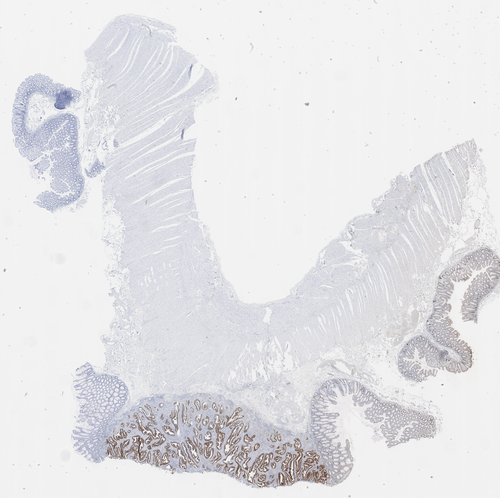

In [254]:
IMG_LIST = TP53_Gold
IMG_NUM = 4
LEVEL = 0

img_prefix = IMG_LIST[IMG_NUM][:-4] + '_' + str(LEVEL)

tp53 = open_slide(wsi_path + IMG_LIST[IMG_NUM])
print('Pixels             :' + str(tp53.level_dimensions[LEVEL][0]*tp53.level_dimensions[LEVEL][1]))
print('Max readable pixels:' + str(2**29))
tp53_small = tp53.get_thumbnail((500,500))
tp53_small

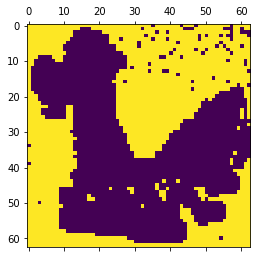

In [255]:
t_mask_tp53 = wsi_tissue_mask(tp53, LEVEL, True)

plt.matshow(np.reshape(t_mask_tp53, t_mask_tp53.shape[::-1]))

In [ ]:
#c_mask_tp53 = wsi_cancer_mask(tp53, LEVEL, 250, 0.37)

plt.matshow(np.reshape(c_mask_tp53, c_mask_tp53.shape[::-1]))

In [ ]:
c_mask_tp53, u_mask_tp53 = wsi_cancer_masks(tp53, LEVEL, 250, 0.4, 0.36, True)
plt.matshow(np.reshape(u_mask_tp53, u_mask_tp53.shape[::-1]))

Threshold: 0.36


In [ ]:
tp53_gen = wsi_tile_gen(tp53, LEVEL, 598, resize = 299)
tiled = plot_masks(tp53_gen, (299,299), t_mask_tp53, c_mask_tp53, 'red', u_mask_tp53)
tiled.convert('RGB').save('../gold_standards/10x/overlays/' + img_prefix + '_segmented_gold.jpeg', 'JPEG')

In [240]:
tp53_gen = wsi_tile_gen(tp53, LEVEL, 299, resize = True)
tiled_small = plot_masks(tp53_gen, (13,13), t_mask_tp53, c_mask_tp53, 'red', u_mask_tp53)
tiled_small.convert('RGB').save('../gold_standards/10x/overlays/' + img_prefix + '_segmented_gold_small.jpeg', 'JPEG')

KeyboardInterrupt: 

In [218]:
os.getcwd()

'/scratch/imb/Andrew/Slides'

In [ ]:
tp53_gen = wsi_tile_gen(tp53, LEVEL, 598, resize = 299)
#save_tiles(tp53_gen, c_mask_tp53, t_mask_tp53, prefix = img_prefix)
save_gold_tiles(tp53_gen, c_mask_tp53, t_mask_tp53, u_mask_tp53, prefix = img_prefix)

**Visualise all TP53 Images with constant DAB threshold**

In [ ]:
#os.chdir('C:\\Users\\Andrew\\Pictures\\IMB')
#os.getcwd()
LEVEL = 1

for img_name in TP53_all_imgs:
    img_prefix = img_name[:-4] + '_' + str(LEVEL)
    print(img_prefix)
    tp53 = open_slide(wsi_path + img_name)
    t_mask_tp53 = wsi_tissue_mask(tp53, LEVEL)
    c_mask_tp53 = wsi_cancer_mask(tp53, LEVEL, 250, 0.3808)
    tp53_gen = wsi_tile_gen(tp53, LEVEL, 299)
    tiled = plot_masks(tp53_gen, (299,299), t_mask_tp53, c_mask_tp53, 'red')
    tiled.convert('RGB').save('../Overlays/' + img_prefix + '_segmented.jpeg', 'JPEG')

1792_T_9500_2_TP53_0
Threshold: 0.3808


**Use Automatic Thresholding to predict on 5 paired images**

In [260]:
path_tp53_paired = '/scratch/imb/Quan/wsi_5/'

TP53_pairs = [img for img in os.listdir(path_tp53_paired) if 'TP53' in img]

TP53_pairs

['1820-N-10545A-4-TP53.svs',
 '2065-N-12752A-4-TP53.svs',
 '2065-T-12756A-4-TP53.svs',
 '2112-T-12335F-4-TP53.svs',
 '2171-T-11524A-4-TP53.svs',
 '1820-T-105452F-4-TP53.svs',
 '2171-N-11521A-4-TP53.svs',
 '2148-T-11393A-4-TP53.svs',
 '2148-N-11397A-4-TP53.svs',
 '2112-N-12341B-4-TP53.svs']

In [285]:
os.path.join(path_tp53_paired, 'cancer', 'normal')

'/scratch/imb/Quan/wsi_5/cancer/normal'

In [272]:
#10x
LEVEL = 0

for img_name in TP53_pairs:
    img_prefix = img_name[:-4] + '_' + '10x'
    print(img_prefix)
    tp53 = open_slide(path_tp53_paired + img_name)
    t_mask_tp53 = wsi_tissue_mask(tp53, LEVEL, True)
    c_mask_tp53 = wsi_cancer_mask(tp53, LEVEL, 250, half_res = True)
    tp53_gen = wsi_tile_gen(tp53, LEVEL, 598, resize = 299)
    tiled = plot_masks(tp53_gen, (299,299), t_mask_tp53, c_mask_tp53, 'red')
    tiled.convert('RGB').save('../thresh_predictions/10x/overlays/' + img_prefix + '_segmented.jpeg', 'JPEG')
    tp53_gen = wsi_tile_gen(tp53, LEVEL, 598, resize = 299)
    save_tiles('/scratch/imb/Andrew/thresh_predictions/10x/',tp53_gen, c_mask_tp53, t_mask_tp53, prefix = img_prefix)

1820-N-10545A-4-TP53_10x
Threshold: 0.3932127391415152
Whole Image Size is 89 x 69
Done
2065-N-12752A-4-TP53_10x
Threshold: 0.3975165213935833
Whole Image Size is 83 x 56
Done
2065-T-12756A-4-TP53_10x
Threshold: 0.3596268519660936
Whole Image Size is 73 x 56
Done
2112-T-12335F-4-TP53_10x
Threshold: 0.37184030180104644
Whole Image Size is 96 x 73
Done
2171-T-11524A-4-TP53_10x
Threshold: 0.37944651971710885
Whole Image Size is 113 x 71
Done
1820-T-105452F-4-TP53_10x
Threshold: 0.39817795108852194
Whole Image Size is 86 x 65
Done
2171-N-11521A-4-TP53_10x
Threshold: 0.3979564971627259
Whole Image Size is 79 x 65
Done
2148-T-11393A-4-TP53_10x
Threshold: 0.3732650068667422
Whole Image Size is 86 x 70
Done
2148-N-11397A-4-TP53_10x
Threshold: 0.39814589134756356
Whole Image Size is 86 x 76
Done
2112-N-12341B-4-TP53_10x
Threshold: 0
Whole Image Size is 99 x 73
Done


In [ ]:
#20x
#Start time: 23/05/2019 9:02AM
LEVEL = 0

for img_name in TP53_pairs:
    img_prefix = img_name[:-4] + '_' + str(LEVEL)
    print(img_prefix)
    tp53 = open_slide(path_tp53_paired + img_name)
    t_mask_tp53 = wsi_tissue_mask(tp53, LEVEL)
    c_mask_tp53 = wsi_cancer_mask(tp53, LEVEL, 250)
    tp53_gen = wsi_tile_gen(tp53, LEVEL, 299)
    tiled = plot_masks(tp53_gen, (299,299), t_mask_tp53, c_mask_tp53, 'red')
    tiled.convert('RGB').save('../thresh_predictions/20x/overlays/' + img_prefix + '_segmented.jpeg', 'JPEG')
    tp53_gen = wsi_tile_gen(tp53, LEVEL, 299)
    save_tiles('/scratch/imb/Andrew/thresh_predictions/20x/',tp53_gen, c_mask_tp53, t_mask_tp53, prefix = img_prefix)

### Feature Based Image Registration

Based on tutorial: https://www.learnopencv.com/image-alignment-feature-based-using-opencv-c-python/

In [49]:
import cv2
from skimage import exposure
from skimage.transform import match_histograms

In [532]:
class ImgRegistration:
    def __init__(self, img, reference, max_features = 100000, good_match_percent = 0.025):
        self.img = img
        self.ref = reference
        self.max_features = max_features
        self.good_match_percent = good_match_percent
        
    def detect_and_match_features(self):
        #Detect ORB features and compute descriptors
        orb = cv2.ORB_create(self.max_features)
        keypoints_img, descriptors_img = orb.detectAndCompute(self.img, None)
        keypoints_ref, descriptors_ref = orb.detectAndCompute(self.ref, None)

        #Match features
        matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
        matches = matcher.match(descriptors_img, descriptors_ref, None)

        #Sort matches by score
        matches.sort(key=lambda x: x.distance, reverse=False)

        # Remove not so good matches
        numGoodMatches = int(len(matches) * self.good_match_percent)
        matches = matches[:numGoodMatches]
        
        #Draw Matches
        self.imMatches = cv2.drawMatches(self.img, keypoints_img, self.ref, keypoints_ref, matches, None)
        
        # Extract location of good matches
        points_img = np.zeros((len(matches), 2), dtype=np.float32)
        points_ref = np.zeros((len(matches), 2), dtype=np.float32)

        for i, match in enumerate(matches):
            points_img[i, :] = keypoints_img[match.queryIdx].pt
            points_ref[i, :] = keypoints_ref[match.trainIdx].pt
            
        # Find homography
        self.h, mask = cv2.findHomography(points_img, points_ref, cv2.RANSAC)
    
    def show_matches(self):
        fig, ax = plt.subplots(figsize=(18, 20))
        ax.imshow(self.imMatches, interpolation='nearest')
        ax.axis('off')
        fig.tight_layout()
        
    def get_aligned_img(self, img):
        # Use homography
        height, width = self.ref.shape
        self.aligned = cv2.warpPerspective(np.array(img), self.h, (width, height))
        return self.aligned

In [473]:
def filter_green_channel(img, g_thresh):
    new_img = img.copy()
    pixels = new_img.load()
    for i in range(img.size[0]):   #For every column
        for j in range(img.size[1]):    #For every row
            if pixels[i,j][2] > g_thresh:
                pixels[i,j] = (255,255,255)
    return new_img        

def filter_grays(img, tolerance):
    new_img = img.convert('RGB')
    pixels = new_img.load()
    for i in range(img.size[0]):
        for j in range(img.size[1]):
            r, g, b = pixels[i,j]
            rg_diff, rb_diff, gb_diff = abs(r-g) <= tolerance, abs(r-b) <= tolerance, abs(g-b) <= tolerance
            if rg_diff and rb_diff and gb_diff:
                pixels[i,j] = (255,255,255)
    return new_img

In [458]:
pixels = wsi_pil.load()

In [463]:
r,g, b, *args = pixels[1000,1000]

In [487]:
wsi_pil_gn = filter_green_channel(wsi_pil, 240)
wsi_pil_gy = filter_grays(wsi_pil, 3)

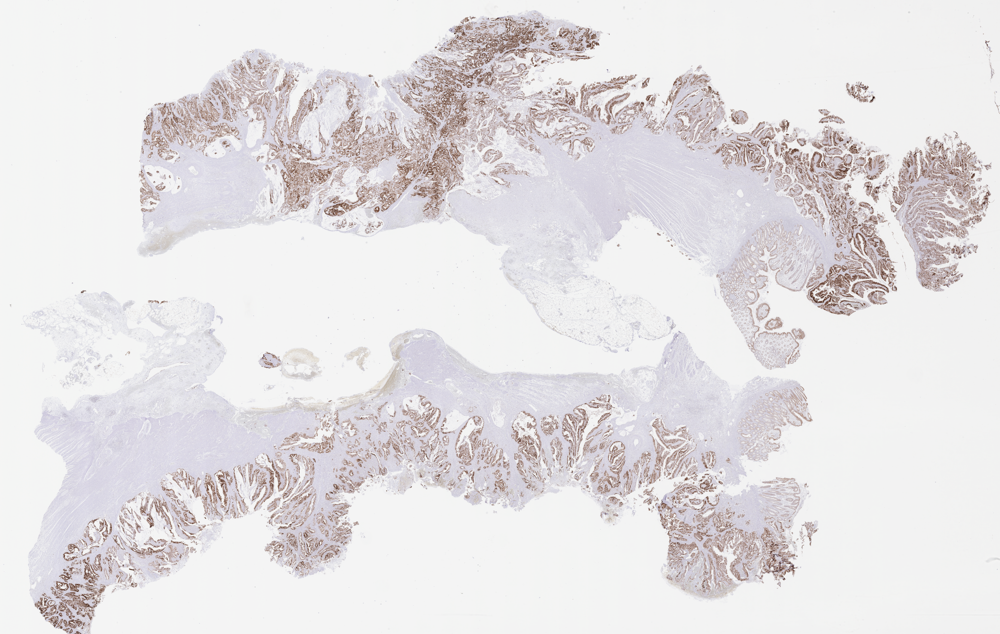

In [488]:
wsi_pil

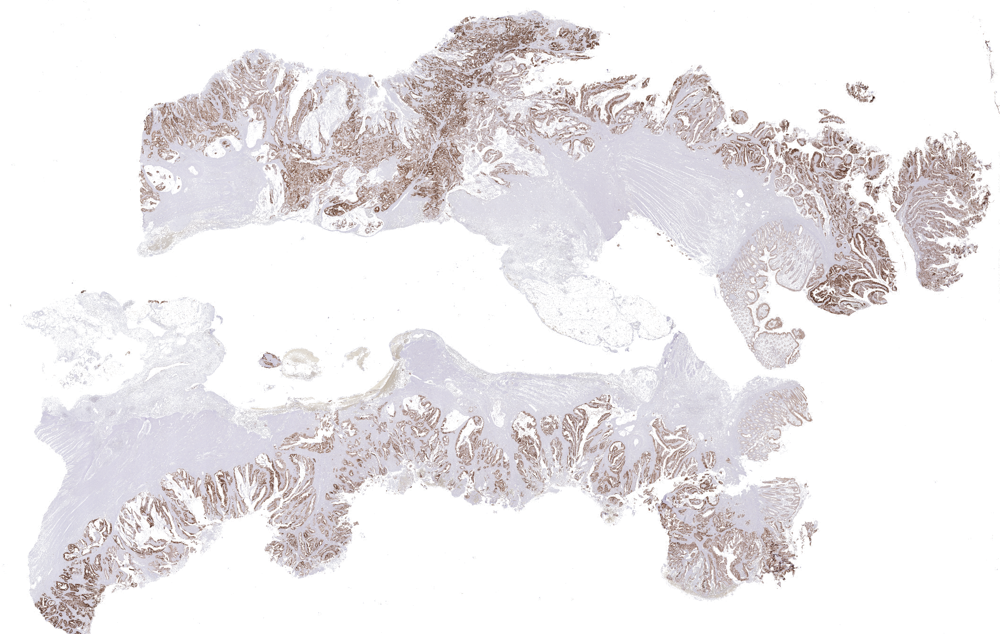

In [489]:
wsi_pil_gy

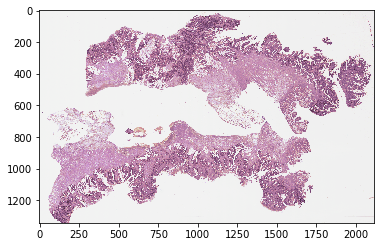

In [501]:
wsi_pil = wsi.read_region((0,0), 3, (2116,1342))
wsi_pil_same_size = wsi.read_region((0,0), 3, (2054, 1429))
wsi_HE_pil = wsi_HE.read_region((0,0), 3, (2054, 1429))

#Histogram matching
reference = np.array(wsi_HE_pil)

matched = match_histograms(np.array(wsi_pil), reference, multichannel = True)
plt.imshow(matched)

In [536]:
#Save pillow images
os.chdir('/scratch/imb/Andrew/Slides/jpegs/')
os.getcwd()

'/scratch/imb/Andrew/Slides/jpegs'

In [538]:
wsi_pil.convert('RGB').save('2171_T_11524A_4_TP53_low.jpeg', 'JPEG')
wsi_HE_pil.convert('RGB').save('2171_T_11524A_4_HandE_low.jpeg', 'JPEG')

In [204]:
#Convert Pillow images to OpenCV format
wsi_cv = np.array(matched)
wsi_cv = wsi_cv[:, :, ::-1].copy()    #converts RGB to BGR
wsi_HE_cv = np.array(wsi_HE_pil)
wsi_HE_cv = wsi_HE_cv[:, :, ::-1].copy()

#Convert images to grayscale
wsi_cv_gray = cv2.cvtColor(wsi_cv, cv2.COLOR_BGR2GRAY)
wsi_HE_cv_gray = cv2.cvtColor(wsi_HE_cv, cv2.COLOR_BGR2GRAY)

In [510]:
wsi_hed = rgb2hed(filter_grays(wsi_pil.convert('RGB'),3))
wsi_hem = -wsi_hed[:,:, 0]
wsi_HE_hed = rgb2hed(filter_grays(wsi_HE_pil.convert('RGB'),3))
wsi_HE_hem = -wsi_HE_hed[:,:, 0]

wsi_cv_gray = (wsi_hem*255).astype(np.uint8)
wsi_HE_cv_gray = (wsi_HE_hem*255).astype(np.uint8)

#Stretch contrast
wsi_cv_gray = stretch_contrast(wsi_cv_gray)
wsi_HE_cv_gray = stretch_contrast(wsi_HE_cv_gray)

#Match Histogram
reference = wsi_HE_cv_gray
wsi_cv_gray = match_histograms(wsi_cv_gray, reference, multichannel = False).astype(np.uint8)

In [495]:
wsi_cv_gray

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255]], dtype=uint8)

In [ ]:
plt.imshow(wsi_pil_bw, cmap = plt.cm.gray)

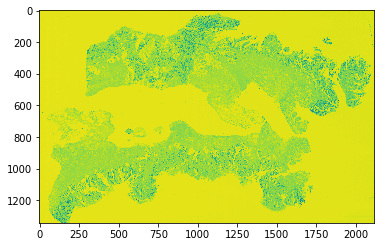

In [418]:
plt.imshow(wsi_hem)

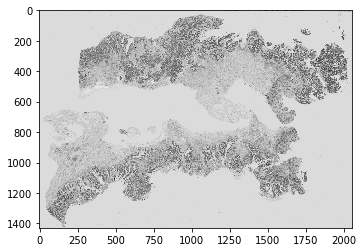

In [512]:
plt.imshow(wsi_HE_hem, cmap = plt.cm.gray)

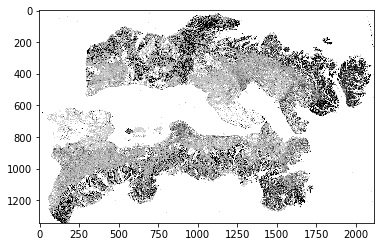

In [511]:
plt.imshow(wsi_cv_gray, cmap = plt.cm.gray)

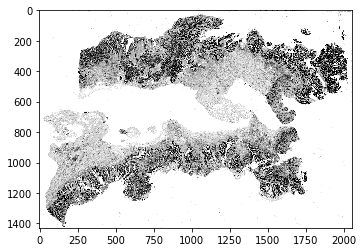

In [513]:
plt.imshow(wsi_HE_cv_gray, cmap = plt.cm.gray)

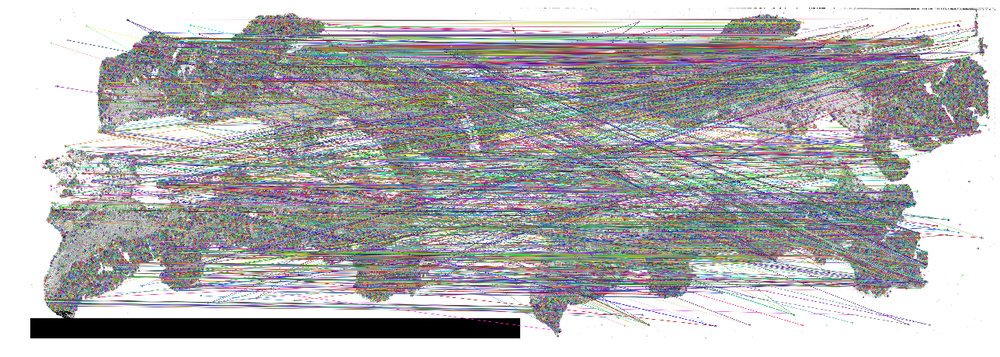

In [526]:
MAX_FEATURES = 200000
GOOD_MATCH_PERCENT = 0.01
ImgReg = ImgRegistration(wsi_cv_gray, wsi_HE_cv_gray, MAX_FEATURES, GOOD_MATCH_PERCENT)
ImgReg.detect_and_match_features()
ImgReg.show_matches()

In [ ]:
#cv2.imwrite("matches.jpg", imMatches)

In [527]:
wsi_aligned = ImgReg.get_aligned_img(wsi_pil)

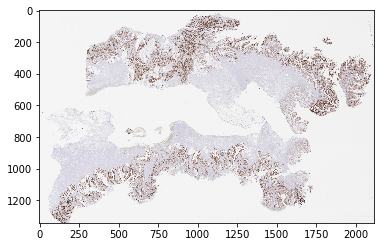

In [158]:
plt.imshow(wsi_pil)

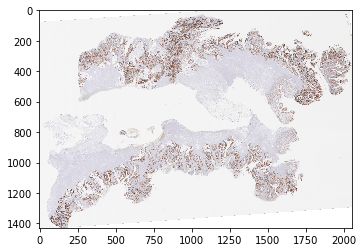

In [521]:
plt.imshow(wsi_aligned)

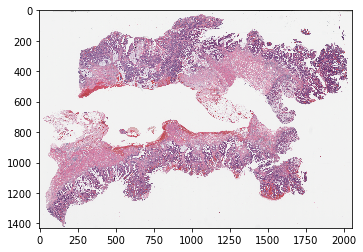

In [229]:
plt.imshow(wsi_HE_cv[:, :, ::-1].copy() )

In [388]:
def show_alignment(aligned, reference):
    aligned_hed, reference_hed = rgb2hed(aligned), rgb2hed(reference)
    aligned_hem, reference_hem = -aligned_hed[:,:,0], -reference_hed[:,:,0]
    aligned_hem, reference_hem = stretch_contrast(aligned_hem, 0.5, 99.5), stretch_contrast(reference_hem, 0.5, 99.5)
    aligned_hem = match_histograms(aligned_hem, reference_hem, multichannel = False)
    aligned_hem, reference_hem = (aligned_hem*255).astype(np.uint8), (reference_hem*255).astype(np.uint8)
    aligned_hem_pil, reference_hem_pil = Image.fromarray(aligned_hem), Image.fromarray(reference_hem)
    blank_img = Image.new(('L'), reference_hem_pil.size, color = 0)
    comparison = Image.merge('RGB', [aligned_hem_pil, reference_hem_pil, blank_img])
    return aligned_hem, reference_hem, comparison

In [528]:
aligned_hem, ref_hem, comparison = show_alignment(Image.fromarray(wsi_aligned).convert('RGB'), wsi_HE_pil.convert('RGB'))

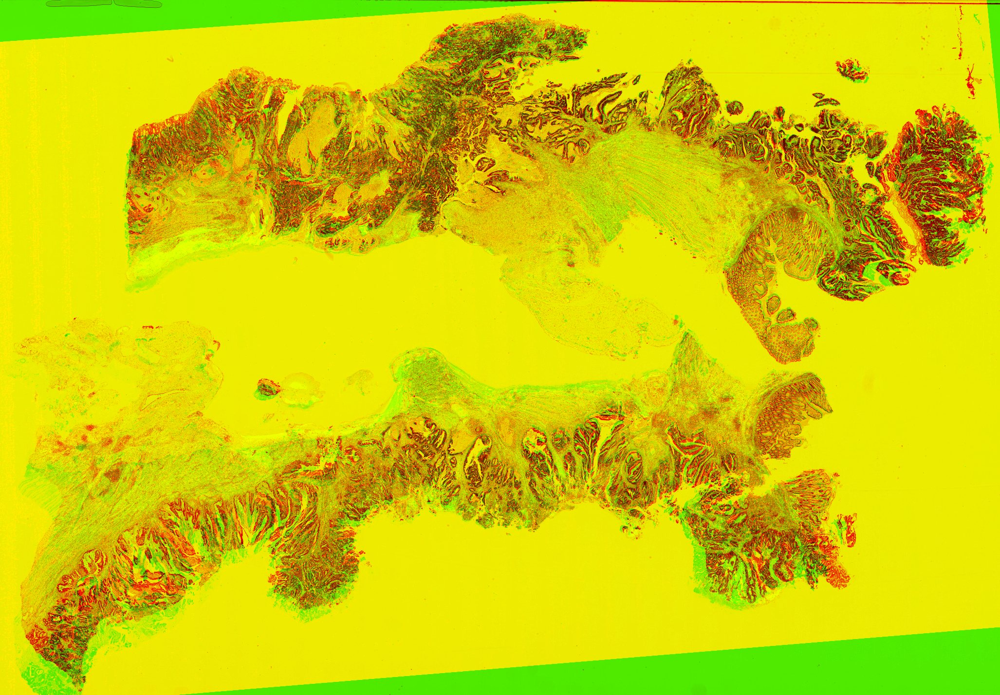

In [529]:
comparison

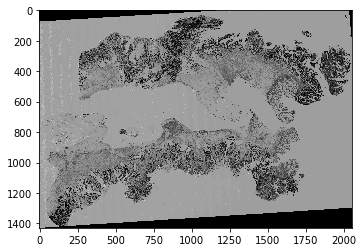

In [375]:
plt.imshow(aligned_hem, cmap = plt.cm.gray)

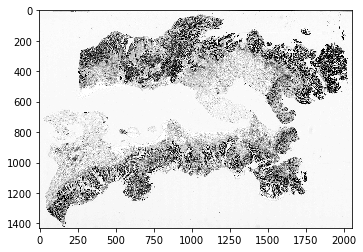

In [324]:
plt.imshow(ref_hem, cmap = plt.cm.gray)

In [393]:
aligned_hem2, ref_hem2, comparison2 = show_alignment(wsi_pil_same_size.convert('RGB'), wsi_HE_pil.convert('RGB'))

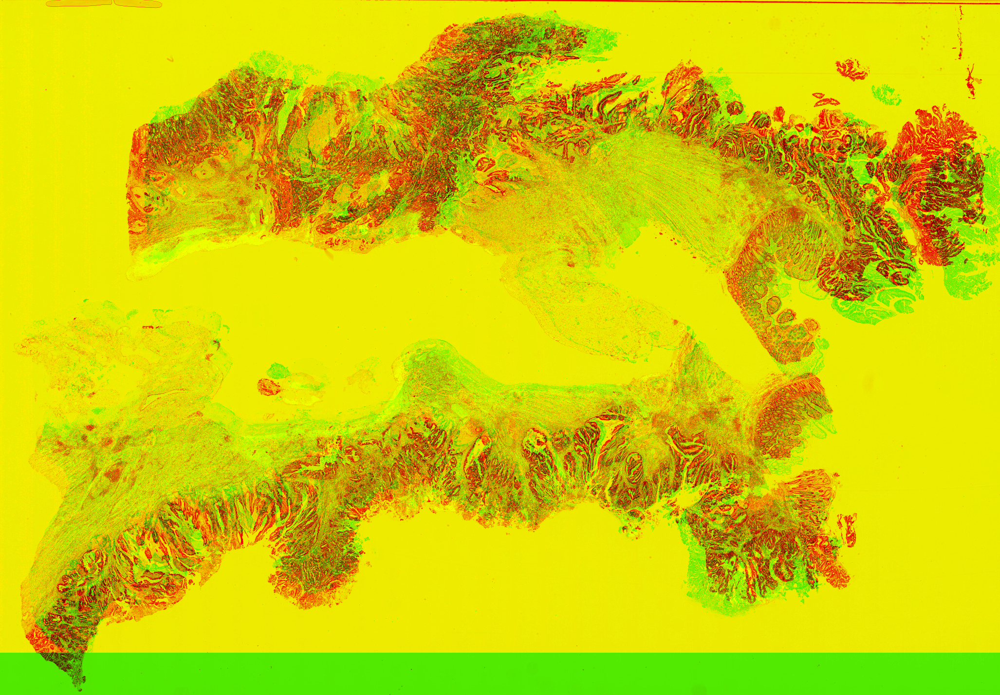

In [395]:
comparison2

In [295]:
wsi_aligned_hed = rgb2hed(Image.fromarray(wsi_aligned).convert('RGB'))

wsi_aligned_hem = -wsi_aligned_hed[:,:, 0]
#wsi_aligned_hem = stretch_contrast(wsi_aligned_hem)
reference = wsi_HE_cv_gray
wsi_aligned_hem = match_histograms(wsi_aligned_hem*255, reference, multichannel = False).astype(np.uint8)

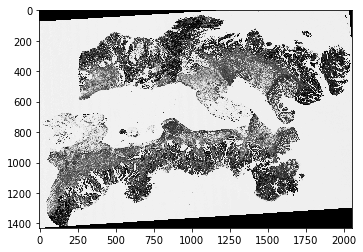

In [296]:
plt.imshow(wsi_aligned_hem, cmap = plt.cm.gray)

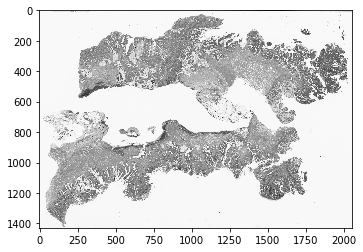

In [297]:
plt.imshow(wsi_HE_cv_gray, cmap = plt.cm.gray)

In [298]:
wsi_aligned_hem_pil = Image.fromarray(wsi_aligned_hem)
wsi_HE_gray_pil = Image.fromarray(wsi_HE_cv_gray)

In [299]:
wsi_compare_2 = Image.merge('RGB', [wsi_aligned_hem_pil, wsi_HE_gray_pil, Image.new(('L'), (2054, 1429), color = 0)])

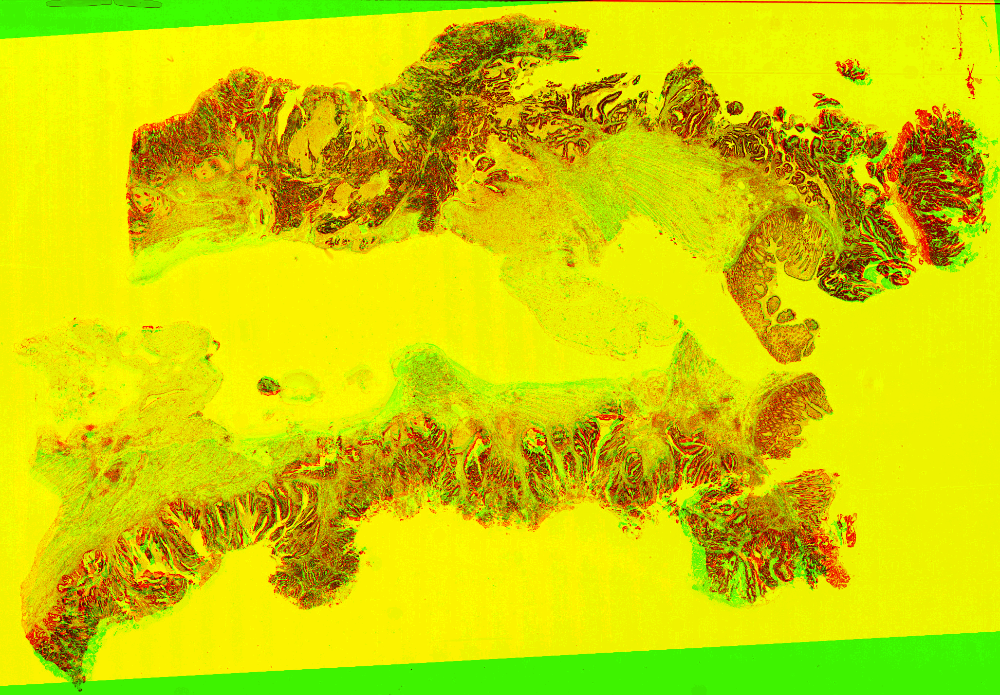

In [267]:
wsi_compare

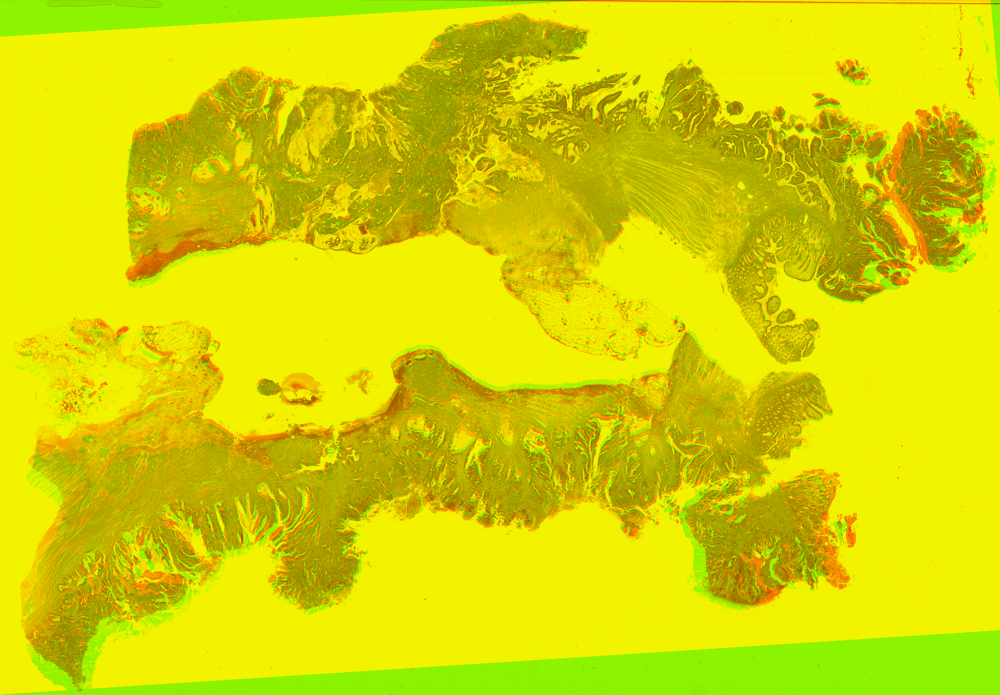

In [300]:
wsi_compare_2

In [48]:
wsi_HE_pil.getbands()

('R', 'G', 'B', 'A')

In [ ]:
tissue_local = local_otsu(wsi_HE_pil.convert('L'), 101)

In [ ]:
size = 250
tissue_mask_tgen = tile_gen(ihc2gray(tissue_local), size)
t_mask = tissue_mask(tissue_mask_tgen, 250)
tgen = wsi_tile_gen(wsi_HE, 3, size)
#tgen = tile_gen(wsi_aligned, size)
plot_mask(tgen, (size,size), c_mask, 'lime')